# Conditional Diffusion Matching

This notebook is a self-contained example of conditional diffusion matching. We implement a number of different simulation-free methods for learning diffusion models. They differ based on the interpolant used and the loss function used to train them.

In this notebook we implement 5 models that can map from a source distribution $q_0$ to a target distribution $q_1$:
* Conditional Flow Matching (CFM)
    * This is equivalent to the basic (non-rectified) formulation of "Flow Straight and Fast: Learning to Generate and Transfer Data with Rectified Flow" [(Liu et al. 2023)](https://openreview.net/forum?id=XVjTT1nw5z)
    * Is similar to "Stochastic Interpolants" [(Albergo et al. 2023)](https://openreview.net/forum?id=li7qeBbCR1t) with a non-variance preserving interpolant.
    * Is similar to "Flow Matching" [(Lipman et al. 2023)](https://openreview.net/forum?id=PqvMRDCJT9t) but conditions on both source and target.
* Optimal Transport CFM (OT-CFM), which directly optimizes for dynamic optimal transport
* Schrödinger Bridge CFM (SB-CFM), which optimizes for Schrödinger Bridge probability paths
* "Building Normalizing Flows with Stochastic Interpolants" [(Albergo et al. 2023)](https://openreview.net/forum?id=li7qeBbCR1t) this corresponds to "VP-CFM" in our README referring to its variance preserving properties.
* "Action Matching: Learning Stochastic Dynamics From Samples" [(Neklyudov et al. 2022)](https://arxiv.org/abs/2210.06662)

Note that this Flow Matching is different from the Generative Flow Network Flow Matching losses. Here we specifically regress against continuous flows, rather than matching inflows and outflows.

In [16]:
%load_ext autoreload
%autoreload 2
import math
import os
import time

import matplotlib.pyplot as plt
import numpy as np
import ot as pot
import torch
import torchdyn
from torchdyn.core import NeuralODE
from torchdyn.datasets import generate_moons
import torchsde

from torchcfm.conditional_flow_matching import *
from torchcfm.conditional_diffusion_matching import *
from torchcfm.models.models import *
from torchcfm.utils import *

savedir = "models/8gaussian-moons"
os.makedirs(savedir, exist_ok=True)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Conditional Diffusion Matching with Brownian Bridge

First we implement the basic conditional diffusion matching. As in the paper, we have
$$
\begin{align}
z&=(x_0, x_1) \\
\pi(z)&=\pi_{0}(x_0)\pi_{1}(x_1) \\
p(t,x|z)&=\mathcal{N}(x|tx_1+(1-t)x_0,t(1-t)I) \\
u(t,x|z)&=(x_1-x)/(1-t)
\end{align}
$$

5000: loss 10.538 time 34.40


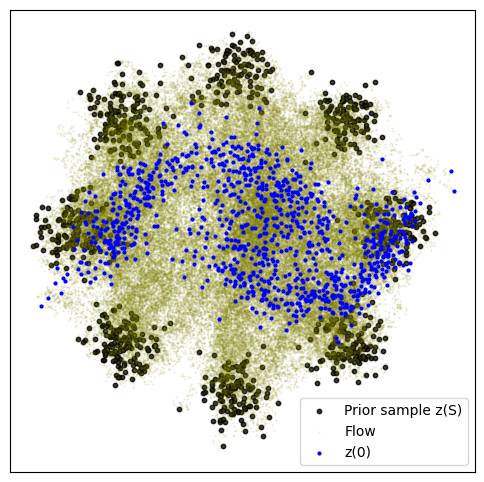

10000: loss 10.172 time 36.71


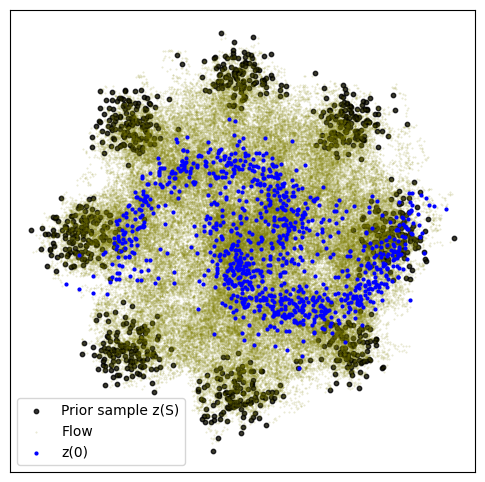

15000: loss 8.629 time 37.42


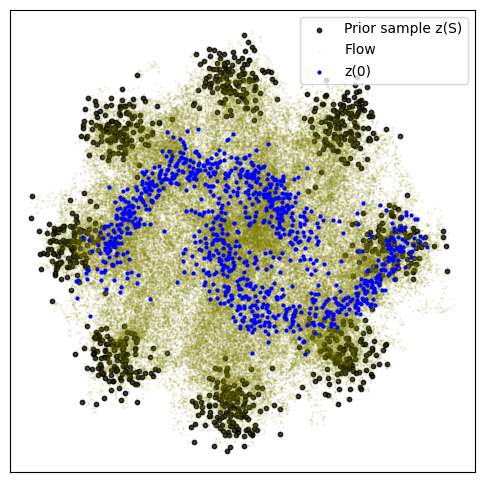

20000: loss 8.513 time 38.29


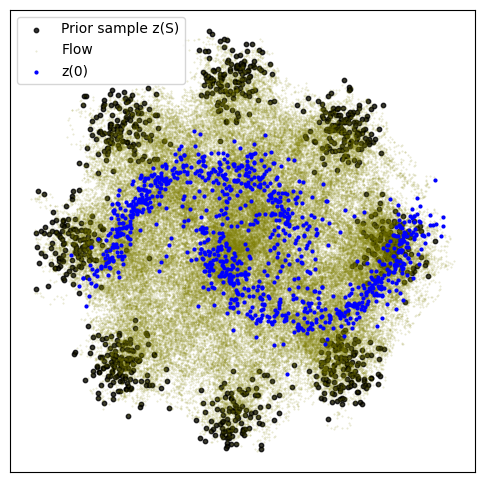

CPU times: user 2h 32min 57s, sys: 13.4 s, total: 2h 33min 10s
Wall time: 2min 31s


In [4]:
%%time
dim = 2
batch_size = 256
model = MLP(dim=dim, time_varying=True)
optimizer = torch.optim.Adam(model.parameters())
DM = ConditionalDiffusionMatcher()

start = time.time()
for k in range(20000):
    optimizer.zero_grad()

    x0 = sample_8gaussians(batch_size)
    x1 = sample_moons(batch_size)

    t, xt, ut = DM.sample_location_and_conditional_flow(x0, x1)

    vt = model(torch.cat([xt, t[:, None]], dim=-1))
    loss = torch.mean((vt - ut) ** 2)

    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        sde = torch_sde_wrapper(model, dim)
        with torch.no_grad():
            x0 = sample_8gaussians(1024)
            t_span = torch.linspace(0, 1, 100)
            traj = torchsde.sdeint(sde, x0, t_span)
        plot_trajectories(traj.cpu().numpy())
torch.save(model, f"{savedir}/cdm_v1.pt")

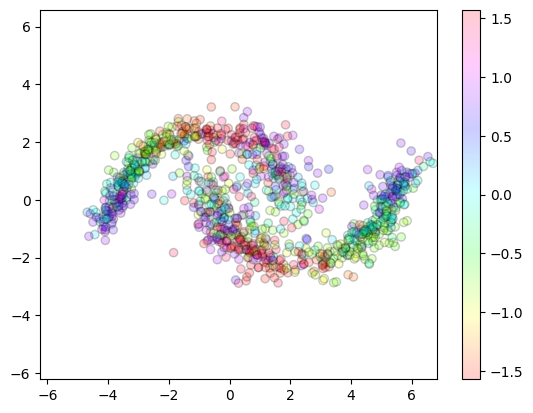

In [17]:
from IPython.display import HTML
sde = torch_sde_wrapper(model, dim)
with torch.no_grad():
    x0 = sample_8gaussians(1024)
    t_span = torch.linspace(0, 1, 100)
    traj = torchsde.sdeint(sde, x0, t_span)
anim = animate_trajectories(traj.cpu().numpy())
HTML(anim.to_jshtml())

5000: loss 5.023 time 20.82


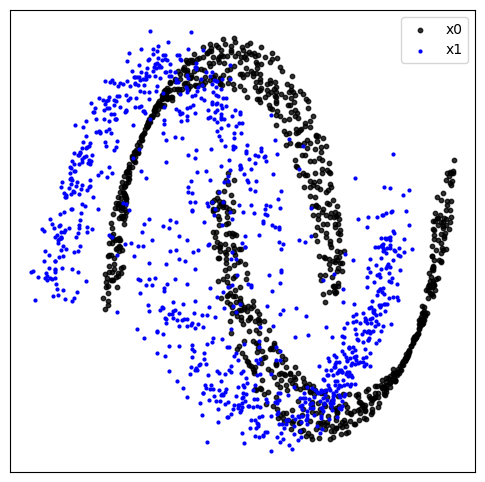

10000: loss 5.961 time 21.21


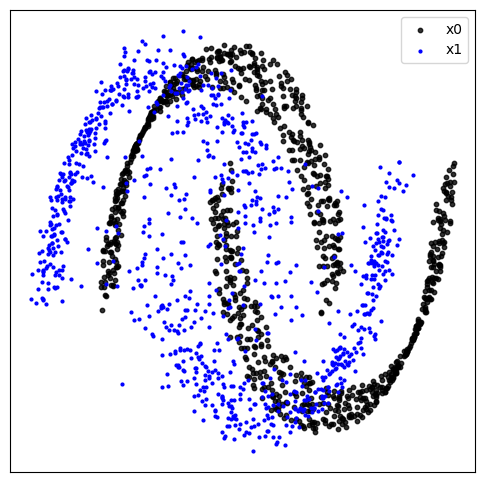

15000: loss 4.037 time 21.70


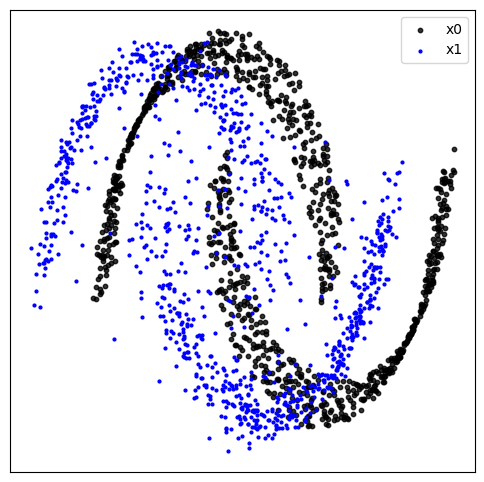

20000: loss 6.924 time 21.27


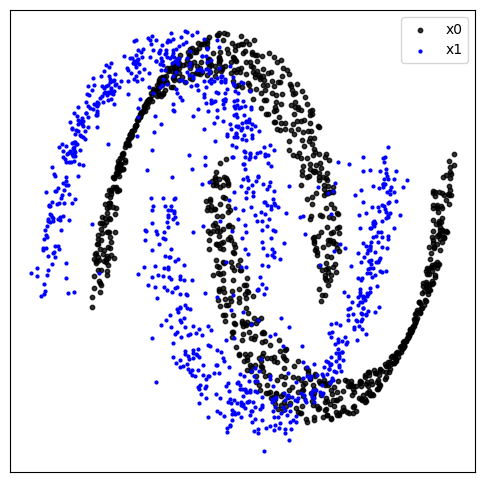

CPU times: user 1h 31min 2s, sys: 10.2 s, total: 1h 31min 12s
Wall time: 1min 27s


In [49]:
%%time
dim = 2
batch_size = 512
sigma = 0.5
model = MLP(dim=dim, time_varying=True)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
DM = ConditionalDiffusionMatcher(sigma)

start = time.time()
for k in range(20000):
    optimizer.zero_grad()

    # x0 = sample_8gaussians(batch_size)
    x0 = sample_moons(batch_size)
    x1 = -sample_moons(batch_size)
    # x0 = torch.zeros_like(x1)

    t, xt, ut = DM.sample_location_and_conditional_flow(x0, x1)

    vt = model(torch.cat([xt, t[:, None]], dim=-1))
    loss = torch.mean((vt - ut) ** 2)

    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        sde = torch_sde_wrapper(model, dim, sigma)
        with torch.no_grad():
            # x0 = sample_8gaussians(1024)
            x0 = sample_moons(1024)
            # x0 = torch.zeros((1024,2))
            t_span = torch.linspace(0, 1, 1000)
            traj = torchsde.sdeint(sde, x0, t_span)
        plot_trajectories(traj.cpu().numpy())
        plt.show()
torch.save(model, f"{savedir}/cdm_v2.pt")

/home/users/eugene/conditional-flow-matching/torchcfm/utils.py:107: RuntimeWarning: invalid value encountered in divide
  sc = ax.scatter(traj[0,:,0], traj[0,:,1], c=colors, cmap='hsv', alpha=0.2, edgecolors='k')


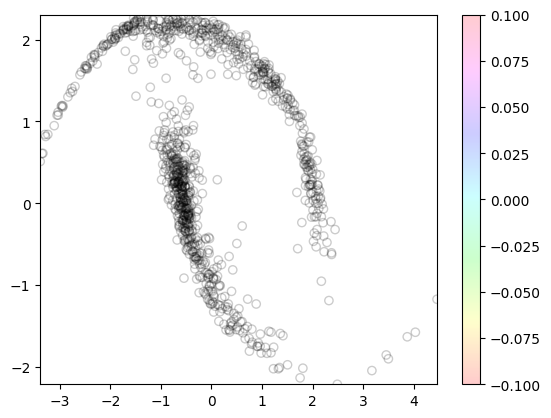

In [36]:
from IPython.display import HTML
sde = torch_sde_wrapper(model, dim, sigma**2)
with torch.no_grad():
    # x0 = sample_8gaussians(1024)
    # x0 = sample_moons(1024)
    x0 = torch.zeros((1024,2))
    t_span = torch.linspace(0, 1, 100)
    traj = torchsde.sdeint(sde, x0, t_span)
anim = animate_trajectories(traj.cpu().numpy())
HTML(anim.to_jshtml())

### Conditional Flow Matching

First we implement the basic conditional flow matching. As in the paper, we have
$$
\begin{align}
z &= (x_0, x_1) \\
q(z) &= q(x_0)q(x_1) \\
p_t(x | z) &= \mathcal{N}(x | t * x_1 + (1 - t) * x_0, \sigma^2) \\
u_t(x | z) &= x_1 - x_0
\end{align}
$$
When $\sigma = 0$ this is equivalent to zero-steps of rectified flow. We find that small $\sigma$ helps to regularize the problem ymmv.

5000: loss 1.770 time 15.66


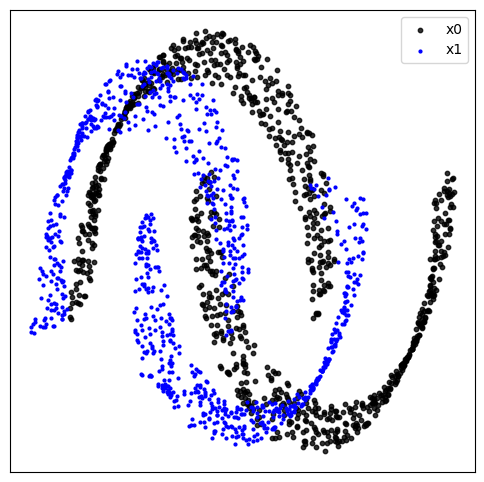

10000: loss 1.241 time 18.64


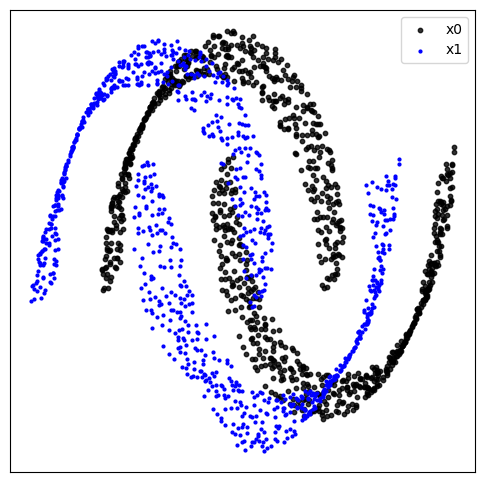

15000: loss 1.480 time 18.96


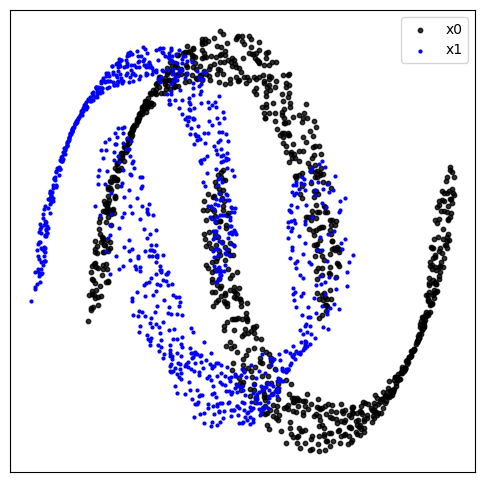

20000: loss 1.601 time 18.79


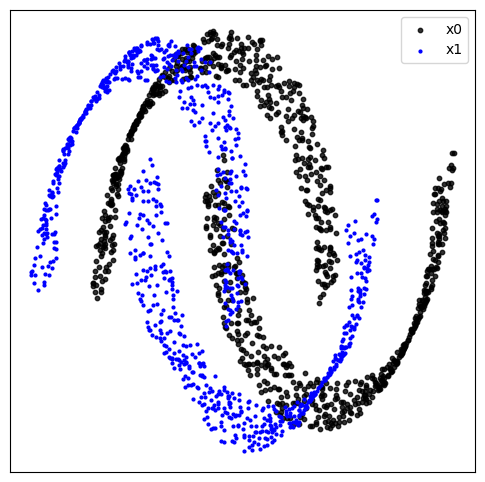

CPU times: user 1h 16min 43s, sys: 6.32 s, total: 1h 16min 50s
Wall time: 1min 12s


In [4]:
%%time
sigma = 0.1
dim = 2
batch_size = 256
model = MLP(dim=dim, time_varying=True)
optimizer = torch.optim.Adam(model.parameters())
FM = ConditionalFlowMatcher(sigma=sigma)

start = time.time()
for k in range(20000):
    optimizer.zero_grad()

    # x0 = sample_8gaussians(batch_size)
    # x1 = sample_moons(batch_size)
    x0 = sample_moons(batch_size)
    x1 = -x0

    t, xt, ut = FM.sample_location_and_conditional_flow(x0, x1)

    vt = model(torch.cat([xt, t[:, None]], dim=-1))
    loss = torch.mean((vt - ut) ** 2)

    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        node = NeuralODE(
            torch_wrapper(model), solver="dopri5", sensitivity="adjoint", atol=1e-4, rtol=1e-4
        )
        with torch.no_grad():
            traj = node.trajectory(
                sample_moons(1024),
                # sample_8gaussians(1024),
                t_span=torch.linspace(0, 1, 100),
            )
            plot_trajectories(traj.cpu().numpy())
torch.save(model, f"{savedir}/cfm_v1.pt")

### Optimal Transport Conditional Flow Matching

Next we implement optimal transport conditional flow matching. As in the paper, here we have
$$
\begin{align}
z &= (x_0, x_1) \\
q(z) &= \pi(x_0, x_1) \\
p_t(x | z) &= \mathcal{N}(x | t * x_1 + (1 - t) * x_0, \sigma^2) \\
u_t(x | z) &= x_1 - x_0
\end{align}
$$
where $\pi$ is the joint of an exact optimal transport matrix. We first sample random $x_0, x_1$, then resample according to the optimal transport matrix as computed with the python optimal transport package. We use the 2-Wasserstein distance with an $L^2$ ground distance for equivalence with dynamic optimal transport.

5000: loss 0.181 time 85.07


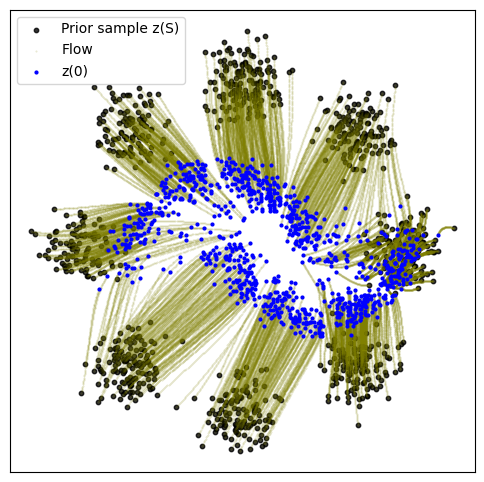

10000: loss 0.158 time 85.81


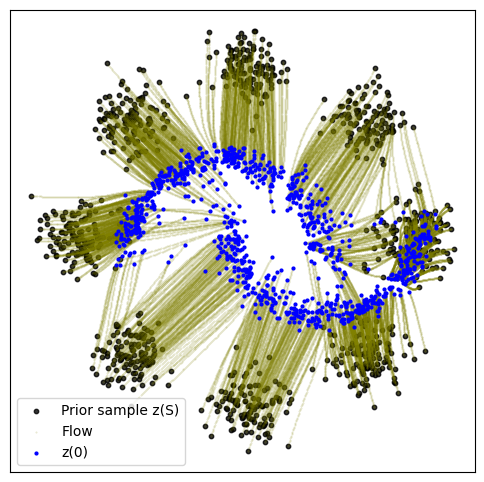

15000: loss 0.136 time 87.51


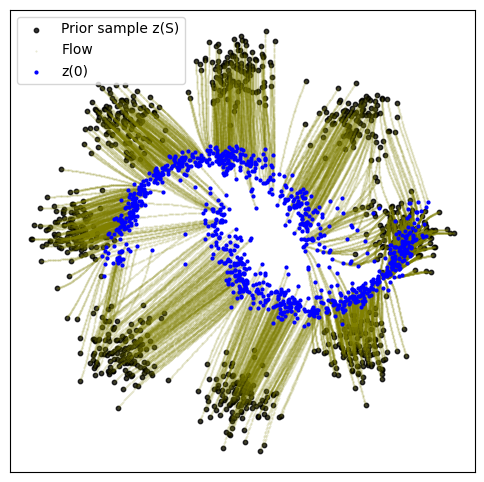

20000: loss 0.136 time 86.06


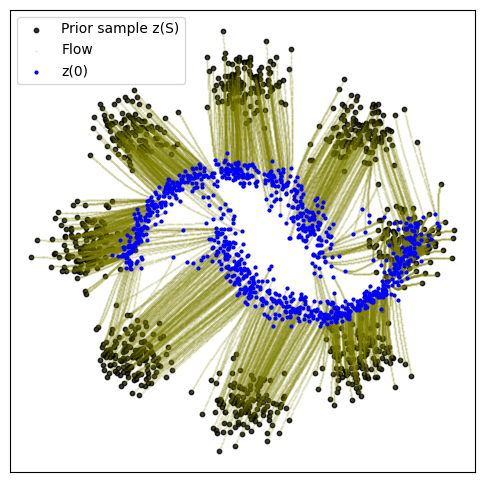

CPU times: user 51min 57s, sys: 2.07 s, total: 51min 59s
Wall time: 5min 45s


In [4]:
%%time
sigma = 0.1
dim = 2
batch_size = 256
model = MLP(dim=dim, time_varying=True)
optimizer = torch.optim.Adam(model.parameters())
FM = ExactOptimalTransportConditionalFlowMatcher(sigma=sigma)

start = time.time()
for k in range(20000):
    optimizer.zero_grad()

    x0 = sample_8gaussians(batch_size)
    x1 = sample_moons(batch_size)

    t, xt, ut = FM.sample_location_and_conditional_flow(x0, x1)

    vt = model(torch.cat([xt, t[:, None]], dim=-1))
    loss = torch.mean((vt - ut) ** 2)

    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        node = NeuralODE(
            torch_wrapper(model), solver="dopri5", sensitivity="adjoint", atol=1e-4, rtol=1e-4
        )
        with torch.no_grad():
            traj = node.trajectory(
                sample_8gaussians(1024),
                t_span=torch.linspace(0, 1, 100),
            )
            plot_trajectories(traj.cpu().numpy())
torch.save(model, f"{savedir}/otcfm_v1.pt")

### Schrödinger Bridge Conditional Flow Matching

Next we implement Schrödinger Bridge conditional flow matching. As in the paper, here we have
$$
\begin{align}
z &= (x_0, x_1) \\
q(z) &= \pi_{2 \sigma^2} (x_0, x_1) \\
p_t(x | z) &= \mathcal{N}( x \mid t x_1 + (1 - t) x_0, t(1-t)\sigma^2)\\
u_t(x | z) &= \frac{1-2t}{2t(1-t)}(x - ( t x_1 + (1-t)x_0) ) + (x_1 - x_0)
\end{align}
$$
where $\pi_{2 \sigma^2}$ is the joint of a **Sinkhorn** optimal transport matrix with regularization $2 \sigma^2$. As in OT-CFM We first sample random $x_0, x_1$, then resample according to the optimal transport matrix as computed with the python optimal transport package. We use the 2-Wasserstein distance with an $L^2$ ground distance for equivalence with the probability flow of a Schrödinger Bridge with reference measure $\sigma W$.

Note that the drift $v_\theta(t,x)$ we learn is *not* equivalent to the drift of the stochastic system, instead it is the drift of the equivalent probability flow ODE, however they are related through $p_t(x)$.

Also note that we use a larger $\sigma$ here both for convergence of the Sinkhorn algorithm and to make the differences more visible.

5000: loss 4.550 time 85.70


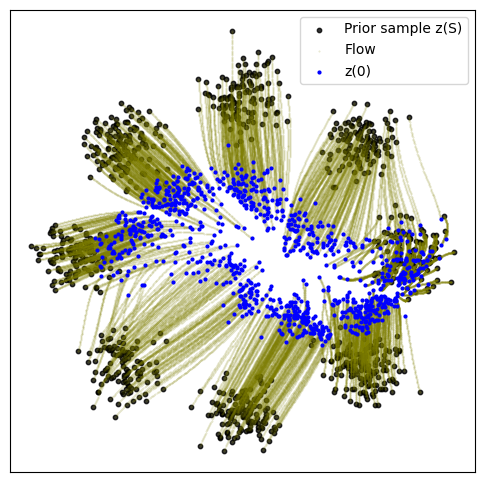

10000: loss 1.237 time 86.54


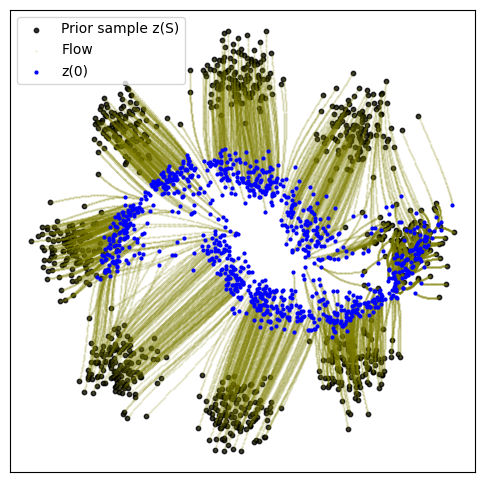

15000: loss 0.721 time 87.70


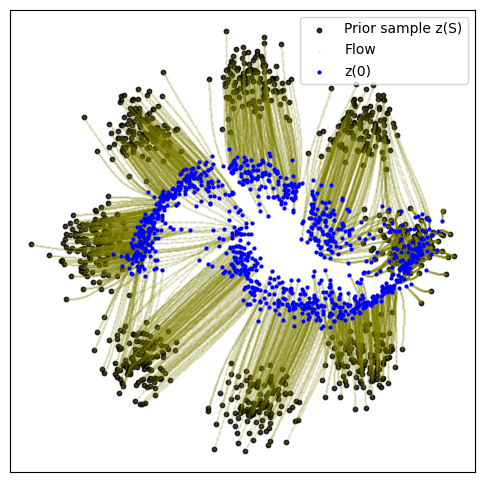

20000: loss 0.680 time 86.27


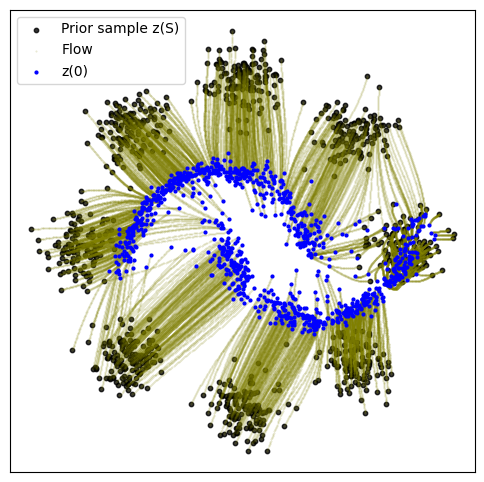

CPU times: user 52min 1s, sys: 1.9 s, total: 52min 2s
Wall time: 5min 47s


In [5]:
%%time
sigma = 0.5
dim = 2
batch_size = 256
model = MLP(dim=dim, time_varying=True)
optimizer = torch.optim.Adam(model.parameters())
# For best performance, use ot_method="exact". To follow the theory, use ot_method="sinkhorn"
FM = SchrodingerBridgeConditionalFlowMatcher(sigma=sigma, ot_method="exact")

start = time.time()
for k in range(20000):
    optimizer.zero_grad()

    x0 = sample_8gaussians(batch_size)
    x1 = sample_moons(batch_size)

    t, xt, ut = FM.sample_location_and_conditional_flow(x0, x1)

    vt = model(torch.cat([xt, t[:, None]], dim=-1))
    loss = torch.mean((vt - ut) ** 2)

    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        node = NeuralODE(
            torch_wrapper(model), solver="dopri5", sensitivity="adjoint", atol=1e-4, rtol=1e-4
        )
        with torch.no_grad():
            traj = node.trajectory(
                sample_8gaussians(1024),
                t_span=torch.linspace(0, 1, 100),
            )
            plot_trajectories(traj.cpu().numpy())
torch.save(model, f"{savedir}/sbcfm_v1.pt")

### Stochastic Interpolants (Albergo et al. 2023)

Next we try a variant suggested by Albergo et al. 2023, Stochastic Interpolants. This is an interesting interpolant because it has some variance preservation properties. Note that the authors consider $\sigma = 0$ (i.e. a Dirac around $\mu_t$) but we keep the general form for consistency. We also refer to this $t$ schedule as "Variance Preserving" and call this VP-CFM. The authors also consider optimizing over more general interpolants $I_t = \alpha(t) x_0 + \beta(t) x_1$ with minor constraints. In our notation, we have
$$
\begin{align}
z &= (x_0, x_1) \\
q(z) &= q(x_0)q(x_1) \\
p_t(x | z) &= \mathcal{N}(x | \cos \left (\frac{\pi t}{2}  \right ) x_0 + \sin \left (\frac{\pi t}{2}  \right ) x_1, \sigma^2) \\
u_t(x | z) &= \frac{\pi}{2} \left (\cos (\frac{\pi t}{2}) x_1 - \sin(\frac{\pi t}{2}) x_0 \right )
\end{align}
$$

5000: loss 13.600 time 12.73


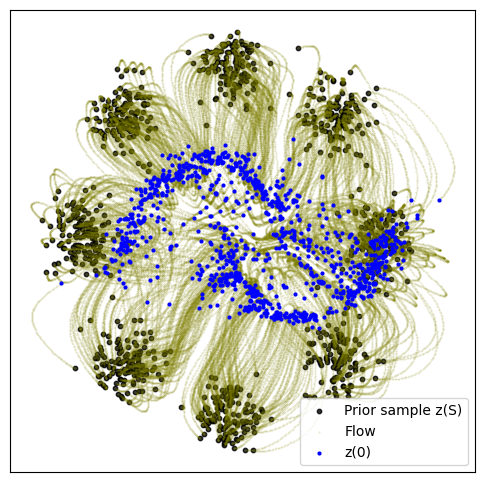

10000: loss 13.479 time 13.79


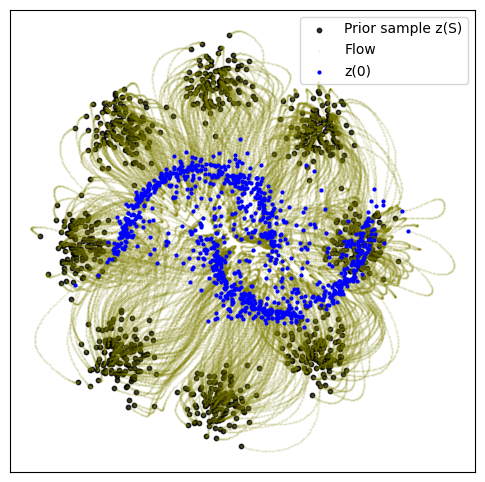

15000: loss 13.023 time 14.19


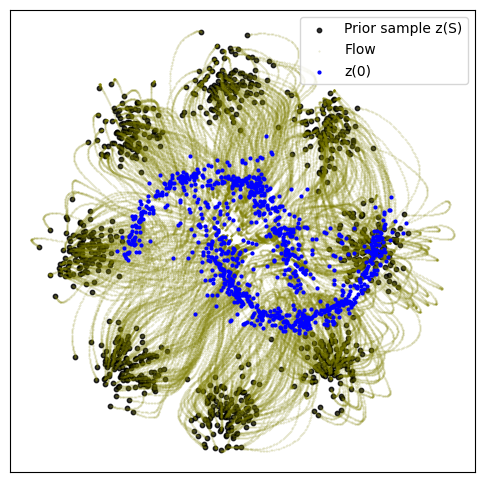

20000: loss 12.768 time 14.39


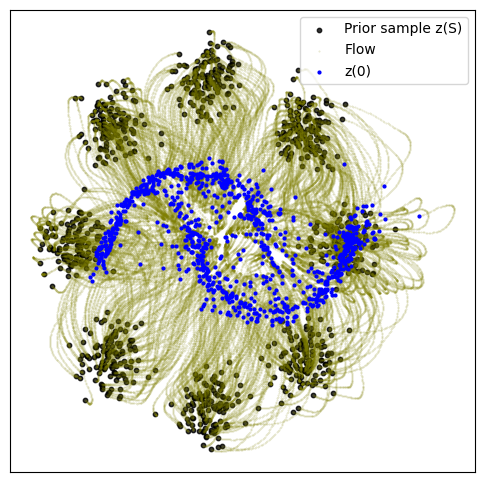

CPU times: user 57.4 s, sys: 1.33 s, total: 58.7 s
Wall time: 56.6 s


In [6]:
%%time
sigma = 0.1
dim = 2
batch_size = 256
model = MLP(dim=dim, time_varying=True)
optimizer = torch.optim.Adam(model.parameters())
pi = math.pi
FM = VariancePreservingConditionalFlowMatcher(sigma=sigma)

start = time.time()
for k in range(20000):
    optimizer.zero_grad()

    x0 = sample_8gaussians(batch_size)
    x1 = sample_moons(batch_size)

    t, xt, ut = FM.sample_location_and_conditional_flow(x0, x1)

    vt = model(torch.cat([xt, t[:, None]], dim=-1))
    loss = torch.mean((vt - ut) ** 2)

    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        node = NeuralODE(
            torch_wrapper(model), solver="dopri5", sensitivity="adjoint", atol=1e-4, rtol=1e-4
        )
        with torch.no_grad():
            traj = node.trajectory(
                sample_8gaussians(1024),
                t_span=torch.linspace(0, 1, 100),
            )
            plot_trajectories(traj.cpu().numpy())
torch.save(model, f"{savedir}/stochastic_interpolant_v1.pt")

### Action Matching (Neklyudov et al. 2022)

Next we try a variant called action matching. Here we parametrize the velocity field $v_\theta(t, x)$ as $\nabla s_\theta(t, x)$ where $s_\theta(t, x): \mathbb{R} \times \mathbb{R}^d \to \mathbb{R}$ is interpreted as the **action**. This is an interesting parameterization because of its link with optimal transport. Namely this velocity performs instantaneous optimal transport flow over $p_t(x)$. This is slightly different than optimal transport between marginals, but is also quite interesting. Action matching can be summarized in the following way:
$$
\begin{align}
z &= (x_0, x_1) \\
q(z) &= q(x_0)q(x_1) \\
p_t(x | z) &= \mathcal{N}(x | (1-t) x_0 + t x_1, \sigma^2)\\
L_{AM}(\theta) &= s_\theta(0, x_0) - s_\theta(1, x_1) + \frac{1}{2} \| \nabla_x s_\theta(t, x_t)\|^2 + \frac{\partial}{\partial t} s_\theta(t, x_t)
\end{align}
$$
Note that the authors again consider $\sigma = 0$ (i.e. a Dirac around $\mu_t$) but we keep the general form for consistency assuming that $\mathcal{N}(x | \mu_t, 0)$ is a degenerate Dirac centered at $\mu_t$. Our standard parameterization seems to be more difficult to fit with this loss (3-layer MLP with width 64 and SELU activations). It's unclear to me why this is the case, but as suggested in their repo using ReLU, Swish, Swish activations works much better.

5000: loss -5.447 time 31.55


/home/campus/kilian.fatras@MAIL.MCGILL.CA/anaconda3/envs/torchcfm2/lib/python3.10/site-packages/torchdyn/numerics/odeint.py:83: UserWarning: Setting tolerances has no effect on fixed-step methods
  warn("Setting tolerances has no effect on fixed-step methods")


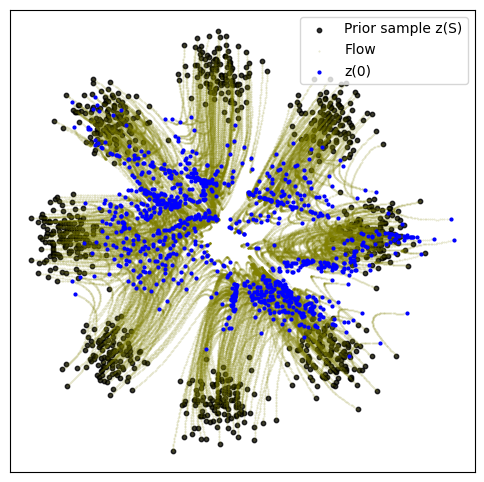

10000: loss -11.290 time 33.58


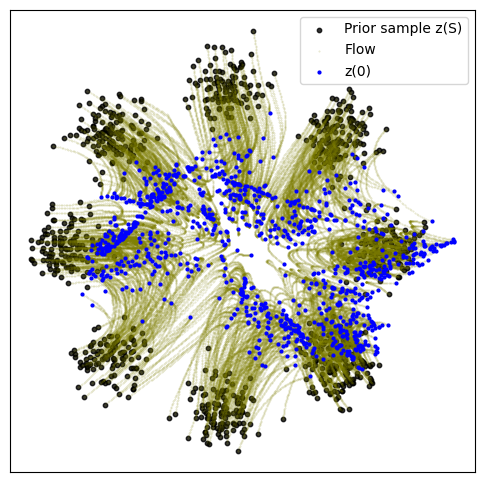

15000: loss -6.900 time 32.21


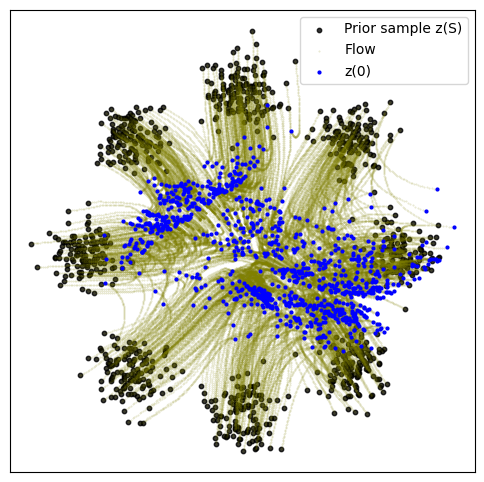

20000: loss -8.775 time 32.05


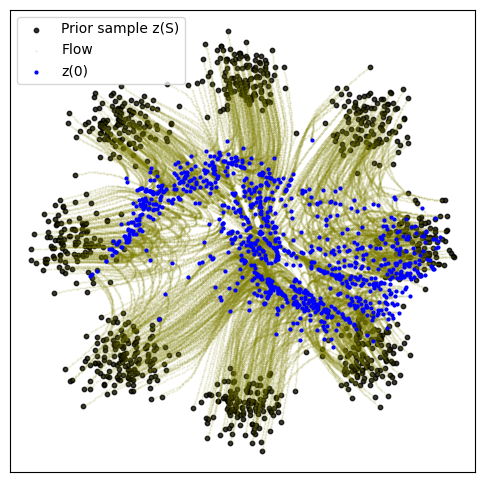

In [7]:
from torchcfm.models.models import GradModel

# %%time
dim = 2
batch_size = 256
action = MLP(dim=dim, out_dim=1, time_varying=True, w=64)
model = GradModel(action)
optimizer = torch.optim.Adam(action.parameters())

start = time.time()
for k in range(20000):
    optimizer.zero_grad()
    t = torch.rand(batch_size, 1).requires_grad_(True)
    x0 = sample_8gaussians(batch_size)
    x1 = sample_moons(batch_size)
    xt = (t * x1 + (1 - t) * x0).detach().requires_grad_(True)
    st = torch.sum(action(torch.cat([xt, t], dim=-1)))
    dsdx, dsdt = torch.autograd.grad(st, (xt, t), create_graph=True, retain_graph=True)
    xt.requires_grad, t.requires_grad = False, False
    a0 = action(torch.cat([x0, torch.zeros(batch_size, 1)], dim=-1))
    a1 = action(torch.cat([x1, torch.ones(batch_size, 1)], dim=-1))
    loss = a0 - a1 + 0.5 * (dsdx**2).sum(1, keepdims=True) + dsdt
    loss = loss.mean()
    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        node = NeuralODE(
            torch_wrapper(model), solver="euler", sensitivity="adjoint", atol=1e-4, rtol=1e-4
        )
        # with torch.no_grad():
        traj = node.trajectory(
            sample_8gaussians(1024),
            t_span=torch.linspace(0, 1, 100),
        ).detach()
        plot_trajectories(traj.cpu().numpy())
torch.save(model, f"{savedir}/action_matching_v1.pt")

5000: loss -10.486 time 30.21


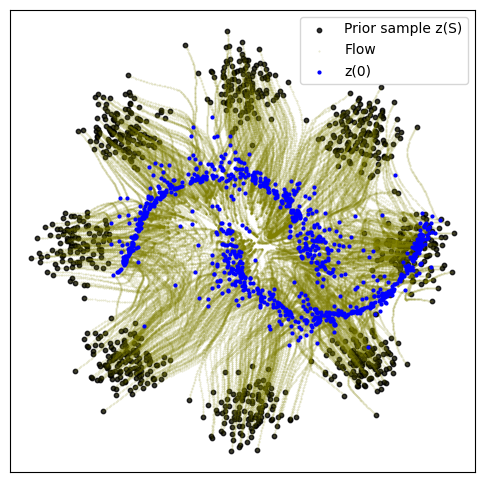

10000: loss -6.505 time 30.96


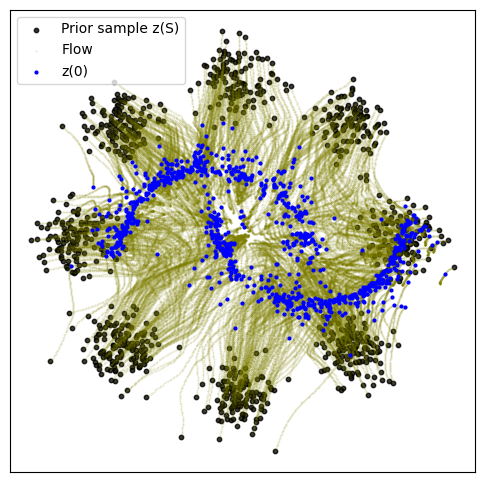

15000: loss -8.307 time 32.21


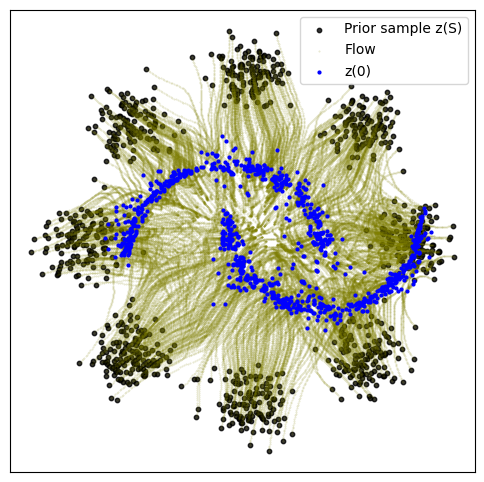

20000: loss -9.079 time 30.71


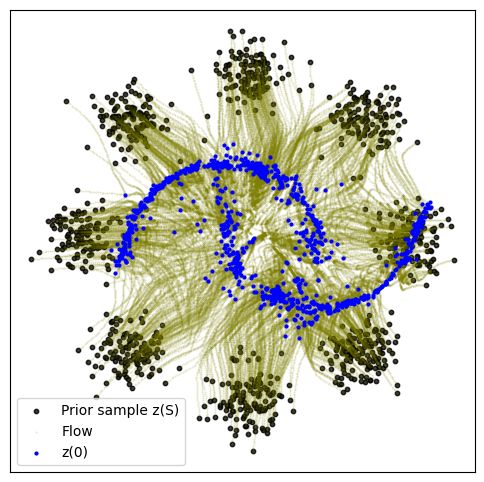

In [8]:
# %%time


class MLP2(torch.nn.Module):
    def __init__(self, dim, out_dim=None, w=64, time_varying=False):
        super().__init__()
        self.time_varying = time_varying
        if out_dim is None:
            out_dim = dim
        self.net = torch.nn.Sequential(
            torch.nn.Linear(dim + (1 if time_varying else 0), w),
            torch.nn.ReLU(),
            torch.nn.Linear(w, w),
            torch.nn.SiLU(),
            torch.nn.Linear(w, w),
            torch.nn.SiLU(),
            torch.nn.Linear(w, out_dim),
        )

    def forward(self, x):
        return self.net(x)


dim = 2
batch_size = 256
action = MLP2(dim=dim, out_dim=1, time_varying=True, w=64)
model = GradModel(action)
optimizer = torch.optim.Adam(action.parameters())

start = time.time()
for k in range(20000):
    optimizer.zero_grad()
    t = torch.rand(batch_size, 1).requires_grad_(True)
    x0 = sample_8gaussians(batch_size)
    x1 = sample_moons(batch_size)
    xt = (t * x1 + (1 - t) * x0).detach().requires_grad_(True)
    st = torch.sum(action(torch.cat([xt, t], dim=-1)))
    dsdx, dsdt = torch.autograd.grad(st, (xt, t), create_graph=True, retain_graph=True)
    xt.requires_grad, t.requires_grad = False, False
    a0 = action(torch.cat([x0, torch.zeros(batch_size, 1)], dim=-1))
    a1 = action(torch.cat([x1, torch.ones(batch_size, 1)], dim=-1))
    loss = a0 - a1 + 0.5 * (dsdx**2).sum(1, keepdims=True) + dsdt
    loss = loss.mean()
    loss.backward()
    optimizer.step()

    if (k + 1) % 5000 == 0:
        end = time.time()
        print(f"{k+1}: loss {loss.item():0.3f} time {(end - start):0.2f}")
        start = end
        node = NeuralODE(
            torch_wrapper(model), solver="euler", sensitivity="adjoint", atol=1e-4, rtol=1e-4
        )
        # with torch.no_grad():
        traj = node.trajectory(
            sample_8gaussians(1024),
            t_span=torch.linspace(0, 1, 100),
        ).detach()
        plot_trajectories(traj.cpu().numpy())
torch.save(model, f"{savedir}/action_matching_swish_v1.pt")

In [ ]:
class brownian(torch.nn.Module):
    """Wraps model to torchsde compatible format."""
    noise_type = 'general'
    sde_type = 'ito'

    def __init__(self, u, dim, sigma):
        super().__init__()
        self.u = u
        self.dim = dim
        self.sigma = sigma

    def f(self, t, x):
        return self.u(torch.cat([x, t.repeat(x.shape[0])[:, None]], 1))

    def g(self, t, x):
        cov = self.sigma ** 2 * torch.eye(self.dim)
        cov = cov.reshape((1, self.dim, self.dim))
        cov = cov.repeat(x.shape[0], 1, 1)
        return cov